### Table Schema
| column | type |
| --- | --- |
| path | text (primary key) |
| filename | text |
| date | text |
| label | text |
| SN | text |
| component | text |
| degree | text |
| capacity | text |
| voltage | text |
| component_class | text |
| width | integer |
| height | integer |

In [1]:
# ! pip install matplotlib
import os
import glob
import sqlite3
import matplotlib.pyplot as plt
from PIL import Image

%matplotlib inline

In [2]:
DB_PATH = "/data/robert/training/p1-dip-metadata.db"

conn = sqlite3.connect(DB_PATH)
# conn = sqlite3.connect(":memory:")
c = conn.cursor()

### mysql Table Schema ( NULL if empty )
| column | type | description |
| --- | --- | --- |
| path | text (primary key) | |
| filename | text (not null) | XX.xxx |
| date | text | YYYYMMDD |
| label | text | |
| online_test | text | OK/NG/Overkill/Leak |
| SN | text | 版號 |
| location | text (not null) | 位號 |
| component | text (not null) | 元件代號 |
| degree | text | 正確角度( 000, 090, 180, 270 ) |
| capacity | text | 正確容值 |
| voltage | text | 正確耐壓值 |
| index_count | text | in case images replaced |
| part_name | text | 料號 |
| width | integer | 圖片寬 |
| height | integer | 圖片長 |
| file_url | text | file-server-url |

In [1]:
# ! pip install mysql-connector-python-rf
import mysql.connector

mydb = mysql.connector.connect(
  host="10.41.241.230",
  port="30003",
  user="aoi_ai",
  password="finding_way_out",
  database="P1"
)

mycursor = mydb.cursor()

In [11]:
# import base64
sql = "INSERT INTO dip_fa (path, filename, date, label, online_test, SN, location, component, degree, capacity, voltage, index_count, part_name, width, height, file_url) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
failed = []
for x in xx:
    try:
        # to_insert = (x[0], x[1], x[2], x[3], None, x[4], x[5], x[-3], x[6], x[7], x[8], None, None, x[-2], x[-1], '10.41.241.230:30038'+x[0], base64.b64encode(open(x[0], "rb").read()).decode("utf-8")) # b64_image too long
        to_insert = (x[0], x[1], x[2], x[3], None, x[4], x[5], x[-3], x[6], x[7], x[8], None, None, x[-2], x[-1], '10.41.241.230:30038'+x[0])
        mycursor.execute(sql, to_insert)
        mydb.commit()
    except Exception as e:
        print(e, x)
        failed.append(x)
print(mycursor.rowcount, "record inserted.")

1062 (23000): Duplicate entry '/data/aoi-wzs-p1-dip-fa-nvidia/image/20190808/OK/CN0C2GT0WS30...' for key 'PRIMARY' ('/data/aoi-wzs-p1-dip-fa-nvidia/image/20190808/OK/CN0C2GT0WS30098200H8A06_L-J-T340-NG_270_000_000.jpg', 'CN0C2GT0WS30098200H8A06_L-J-T340-NG_270_000_000.jpg', '20190808', 'OK', 'CN0C2GT0WS30098200H8A06', 'L-J-T340-NG', '270', '000', '000', 'label', 765, 823)
1406 (22001): Data too long for column 'voltage' at row 1 ('/data/aoi-wzs-p1-dip-fa-nvidia/image/20190909/OK/8SSB27A18611W5ZS99500FP_LabelMAC_270_000_0000.jpg', '8SSB27A18611W5ZS99500FP_LabelMAC_270_000_0000.jpg', '20190909', 'OK', '8SSB27A18611W5ZS99500FP', 'LabelMAC', '270', '000', '0000', 'label', 893, 1037)
1406 (22001): Data too long for column 'capacity' at row 1 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D9/NOAI_Image/2020-09-17/ZHX168E26A020200917092932853_HS_U1_VNEST_0.jpg', 'ZHX168E26A020200917092932853_HS_U1_VNEST_0.jpg', '20200917', 'other', 'ZHX168E26A020200917092932853', 'HS', 'U1', 'VNEST', '0', 'heat

In [31]:
mydb.close()

In [23]:
b64_image = base64.b64encode(open(x[0], "rb").read()).decode("utf-8")
len(b64_image)

104452

## update schema

In [3]:
c.execute('select name from sqlite_master where type="table"').fetchall()
# c.execute("PRAGMA table_info(metadata)").fetchall()

[('metadata',)]

In [7]:
with conn:
#     conn.execute("alter table metadata rename to old_metadata")

    conn.execute("""create table dc_metadata (
        path text primary key,
        filename text,
        date text,
        label text,
        sn text,
        component text,
        degree text,
        capacity text,
        voltage text,
        component_class text,
        width integer,
        height integer)""")

#     conn.execute("""insert into metadata 
#     (path, filename, date, label, sn, component, degree, capacity, voltage, component_class) 
#     select path, filename, date, label, sn, component, degree, capacity, voltage, component_class
#     from old_metadata""")

#     conn.execute("""drop table old_metadata""")

# data-center data

format:
`/data/aoi-wzs-p1-dip-fa-nvidia/data-center/LINE/LABEL/DATE/SN_COMPONENT_DEGREE_CAPACITY_VOLTAGE.jpg`

In [2]:
# ! pip install mysql-connector-python-rf
import mysql.connector
import os
import glob
import matplotlib.pyplot as plt
from PIL import Image

mydb = mysql.connector.connect(
  host="10.41.241.230",
  port="30003",
  user="aoi_ai",
  password="finding_way_out",
  database="P1"
)

mycursor = mydb.cursor()

In [3]:
import time, datetime, glob, os
from PIL import Image
def parse_path(path):
    head, filename = os.path.split(path)
    base, _ = os.path.splitext(filename)

    h = head.split(os.path.sep)
    b = base.split("_")

#     assert len(h) == 7, f"{path}"
    
    try:
        width, height = Image.open(path).size
    except Image.UnidentifiedImageError:
#         print(f"unidentified image: {path}")
        width, height = None, None
    try:
        a = int(h[-2])
        l = h[-1]
        d = h[-2]
        if h[-3] == 'NOAI_Image':
            return None
    except:
        try:
            l = h[-2]
            d = h[-1]
            if h[-2] == 'NOAI_Image':
                return None
            timestamp = time.mktime(datetime.datetime.strptime(d, "%Y-%m-%d").timetuple())
            d = datetime.datetime.fromtimestamp(timestamp).strftime("%Y%m%d")
        except:
            l = h[-1]
            d = None
    # KEYS = ["path", "filename", "date", "label", "sn", "component", "degree", "capacity", "voltage", "component_class", "width", "height"]
    try:
        if (len(b) - 5) % 3 == 0: # 8 because some have extra _000_000_000 in the end
            return [path, filename, d, label_lookup(l), None, b[0], b[1], component_class_lookup(b[1]), b[2], b[3], b[4], None, None, width, height, '10.41.241.230:30038'+path]
        elif len(b) == 6: # 6 because some component has underscore
            return [path, filename, d, label_lookup(l), None, b[0], f"{b[1]}-{b[2]}", component_class_lookup(b[1]), b[3], b[4], b[5], None, None, width, height, '10.41.241.230:30038'+path]
        else:
            return [path, filename, d, label_lookup(l), None, b[0], b[1], component_class_lookup(b[1]), None, None, None, None, None, width, height, '10.41.241.230:30038'+path]
    except:
        return None
#     else:
#         raise ValueError(f"{path}")
#         /data/aoi-wzs-p1-dip-fa-nvidia/data-center/D27/20200716/AI_Error/F136_D12-AOI_02F82811820200609190644873_CF0001_000_270_016.jpg

def component_class_lookup(component):
    table = {
        "B": "buzzer",
        "C": "capacitor",
        "L": "label",
        "H": "heat_sink",
        "J": "connector",
        "K": "jumper_head",
        "T": "jumper",
        "S": "screw",
        "P": "cpu_skt",
    }
    return table.get(component[0], "other")

def label_lookup(label):
    table = {
        "OK": "OK",
        "NG": "NG",
        "OK(Overkill)": "OK",
        "Overkill": "OK",
        "NG(Underkill)": "NG",
        "Underkill": "NG",
    }
    return table.get(label, "other")

In [4]:
to_add = []
pattern = "/data/aoi-wzs-p1-dip-fa-nvidia/data-center/**/*.jpg"
paths = glob.glob(pattern, recursive=True)
for row in map(parse_path, paths):
    try:
        if row[0] == '/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D14/NG/2020-10-16/55502K01001604200090J0D4_HLS1_000_000_000.jpg':
            continue
        elif int(row[2])<20210125:
#             to_add.append(row)
            continue
        elif row[7] == 'heat_sink' or row[7] == 'screw' or row[7] == 'label':
            to_add.append(row)
    except:
        x=row
#         break
len(to_add)

1494

In [10]:
overkill = {
    '000' : [],
    '090' : [],
    '180' : [],
    '270' : [],
    'ok'  : [148, 933, 934, 1144, 1145, 1146, 1147, 1149, 1153, 1293, 1491],
}
leak = {
    'ng': [],
}
np = {
    '000': [926, 927, 1104],
    '090': [],
    '180': [],
    '270': [1102, 1103],
    'ok' : [924, 925],
}

for k, o in overkill.items():
    for oo in o:
        to_add[oo][3] = 'OK'
        to_add[oo][4] = 'Overkill'     
        if k == '000':
            to_add[oo][8] = '000'
        elif k == '090':
            to_add[oo][8] = '090'
        elif k == '180':
            to_add[oo][8] = '180'
        elif k == '270':
            to_add[oo][8] = '270'
    
for k, o in leak.items():
    for oo in o:
        to_add[oo][3] = 'NG'
        to_add[oo][4] = 'Leak'     
        if k == '000':
            to_add[oo][8] = '000'
        elif k == '090':
            to_add[oo][8] = '090'
        elif k == '180':
            to_add[oo][8] = '180'
        elif k == '270':
            to_add[oo][8] = '270'
    
for k, o in np.items():
    for oo in o:    
        if k == '000':
            to_add[oo][3] = 'OK'
            to_add[oo][8] = '000'
        elif k == '090':
            to_add[oo][3] = 'OK'
            to_add[oo][8] = '090'
        elif k == '180':
            to_add[oo][3] = 'OK'
            to_add[oo][8] = '180'
        elif k == '270':
            to_add[oo][3] = 'OK'
            to_add[oo][8] = '270'
        elif k == 'ok':
            to_add[oo][3] = 'OK'

In [12]:
for idx, ta in enumerate(to_add):
    if idx >= 1169 and idx <= 1178:
        to_add[idx][3] = 'OK'
        to_add[idx][4] = 'Overkill' 
    elif idx >= 1459 and idx <= 1464:
        to_add[idx][3] = 'OK'
        to_add[idx][4] = 'Overkill' 
    elif idx >= 1465 and idx <= 1490:
        to_add[idx][3] = 'OK'
        to_add[idx][8] = '000' 

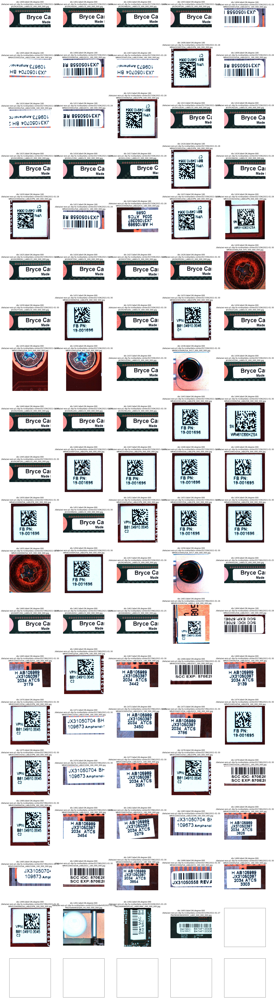

In [13]:
import os
import matplotlib.pyplot as plt
from PIL import Image
h = 20
# h = int(len(to_add)/5)+1
fig_h = h * 6
startofx = 1400
%matplotlib inline
fig, axes = plt.subplots(h, 5, figsize=(30, fig_h), subplot_kw={'xticks': [], 'yticks': []})
fig.subplots_adjust(hspace=0.3, wspace=0.3)
for idx, (ax, value) in enumerate(zip(axes.flat, to_add[startofx:])):
    try:
        ax.imshow(Image.open(value[0]))
        ax.set_title(f'idx:{startofx+idx};label:{value[3]};degree:{value[8]}\n{os.path.split(value[0])[0]}\n{os.path.split(value[0])[1]}')
        ax.axis('off')
    except Exception as e:
        print(e)
        print(value)
#         ax.set_title(f'idx:{startofx+idx};label:{value[3]}\n{os.path.split(value[0])[0]}\n{os.path.split(value[0])[1]}')
        ax.axis('off')

## insert to db

In [15]:
sql = "INSERT INTO dip_fa (path, filename, date, label, online_test, SN, location, component, degree, capacity, voltage, index_count, part_name, width, height, file_url) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
failed = []
for idx, row in enumerate(to_add):
#     print(row)
    try:
        mycursor.execute(sql, row)
        mydb.commit()
#         conn.execute("insert into metadata values (?,?,?,?,?,?,?,?,?,?,?,?)", row)
    except mysql.connector.IntegrityError as err:
        print(f"integrity error: {row[0]}, {err}")
        failed.append(row)
        continue
    except Exception as e:
        print(f"unknown error: {row}, {e}")
        break
#         failed.append(row)
#         continue

integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/data-center/D3/OK/2021-01-25/CN0GCTJ1WS30011J0033A02_SCMH_000_000_000.jpg, 1062 (23000): Duplicate entry '/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D3/OK/2021-01-25/C...' for key 'PRIMARY'
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/OK/2021-01-25/WTH11033PWZA1_HSsrp_000_000_000.jpg, 1062 (23000): Duplicate entry '/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/OK/2021-01-25/W...' for key 'PRIMARY'
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/OK/2021-01-25/WTH110332DZA1_Hsrp_000_000_000.jpg, 1062 (23000): Duplicate entry '/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/OK/2021-01-25/W...' for key 'PRIMARY'
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/OK/2021-01-25/WTH11032NEZA1_Hsrp_000_000_000.jpg, 1062 (23000): Duplicate entry '/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/OK/2021-01-25/W...' for key 'PRIMARY'
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/OK/2021-01-25/

# GoldImages data

format:
`/data/aoi-wzs-p1-dip-fa-nvidia/GoldImages/Overkill/WKXX/COMPONENT/SN_COMPONENT_DEGREE_CAPACITY_VOLTAGE.jpg`

In [4]:
c.execute('select distinct date from metadata where path like "%GoldImages%" order by date desc').fetchone()

('20201127',)

In [19]:
import time, datetime
def parse_path(path):
    date = path.split(os.path.sep)[5]
    head, filename = os.path.split(path)
    base, _ = os.path.splitext(filename)

    h = head.split(os.path.sep)
    b = base.split("_")
    
    try:
        width, height = Image.open(path).size
    except Image.UnidentifiedImageError:
        width, height = None, None
        
    # KEYS = ["path", "filename", "date", "label", "sn", "component", "degree", "capacity", "voltage", "component_class", "width", "height"]
    try:
        if (len(b) - 5) % 3 == 0: # 8 because some have extra _000_000_000 in the end
            return [path, filename, date, label_lookup(h[6]), b[0], b[1], b[2], b[3], b[4], component_class_lookup(b[1]), width, height]
        else:
            return [path, filename, date, label_lookup(h[6]), b[0], b[1], None, None, None, component_class_lookup(b[1]), width, height]
    except:
        return None

def component_class_lookup(component):
    table = {
        "B": "buzzer",
        "C": "capacitor",
        "L": "label",
        "H": "heat_sink",
        "J": "connector",
        "K": "jumper_head",
        "T": "jumper",
        "S": "screw",
        "P": "cpu_skt",
    }
    return table.get(component[0], "other")

def label_lookup(label):
    table = {
        "OK": "OK",
        "NG": "NG",
        "OK(Overkill)": "OK",
        "Overkill": "OK",
        "NG(Underkill)": "NG",
        "Underkill": "NG",
    }
    return table.get(label, "other")

In [20]:
to_add = []
pattern = "/data/aoi-wzs-p1-dip-fa-nvidia/GoldImages/Overkill/21-WK*/**/*.jpg"
paths = glob.glob(pattern, recursive=True)
for row in map(parse_path, paths):
    try:
        if row[-3] == 'heat_sink' or row[-3] == 'screw' or row[-3] == 'label':
            to_add.append(row)
    except:
        x=row
len(to_add)

339

In [14]:
to_change = [17]
for idx, v in enumerate(to_add):
    if idx in to_change:
        v[3]='OK'
        v[6]='000'
# to_add[614][3]='OK'
# to_add[614][6]='180'
# to_add[32][3]='NG'

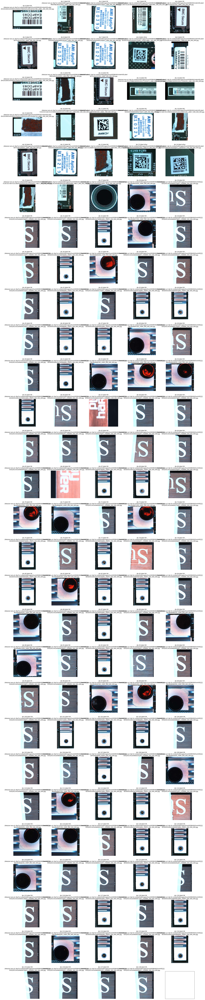

In [15]:
import os
import matplotlib.pyplot as plt
from PIL import Image
# h = 4
h = int(len(to_add)/5)+1
fig_h = h * 6
startofx = 0
%matplotlib inline
fig, axes = plt.subplots(h, 5, figsize=(30, fig_h), subplot_kw={'xticks': [], 'yticks': []})
fig.subplots_adjust(hspace=0.3, wspace=0.3)
for idx, (ax, value) in enumerate(zip(axes.flat, to_add[startofx:])):
    try:
        ax.imshow(Image.open(value[0]))
        ax.set_title(f'idx:{startofx+idx};label:{value[3]}\n{os.path.split(value[0])[0]}\n{os.path.split(value[0])[1]}')
        ax.axis('off')
    except Exception as e:
        print(e)
        print(value)
#         ax.set_title(f'idx:{startofx+idx};label:{value[3]}\n{os.path.split(value[0])[0]}\n{os.path.split(value[0])[1]}')
        ax.axis('off')

## update db

In [32]:
sql = "INSERT INTO dip_fa (path, filename, date, label, online_test, SN, location, component, degree, capacity, voltage, index_count, part_name, width, height, file_url) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
for idx, row in enumerate(to_add):
    try:
        mycursor.execute(f"select path from dip_fa where filename='{row[1]}'")
        test = mycursor.fetchall()
        if len(test) == 0:
            newrow = [row[0], row[1], row[2], 'OK', 'Overkill', row[4], row[5], row[-3], row[6], row[7], row[8], None, None, row[-2], row[-1], '10.41.241.230:30038'+row[0]]
            mycursor.execute(sql, newrow)
            mydb.commit()
        else:
            for t in test:
                mycursor.execute(f"update dip_fa set online_test='Overkill' where path='{t[0]}'")
    except Exception as e:
        print(f"{row}, unknown error: {e}")
        break

# Labeled images

format:
`/data/aoi-wzs-p1-dip-fa-nvidia/image/DATE/LABEL/SN_COMPONENT_DEGREE_CAPACITY_DEGREE.jpg`

In [19]:
KEYS = ["path", "filename", "date", "label", "sn", "component", "degree", "capacity", "voltage", "component_class"]
def parse_path(path):
    head, filename = os.path.split(path)
    base, _ = os.path.splitext(filename)
    
    h = head.split(os.path.sep)
    b = base.split("_")
    
    assert len(h) == 6, f"{path}"
    
    try:
        width, height = Image.open(path).size
    except Image.UnidentifiedImageError:
        print(f"unidentified image: {path}")
        width, height = None, None
    
    if len(b) == 5 or len(b) == 8:
        return [path, filename, h[-2], h[-1], b[0], b[1], b[2], b[3], b[4], component_class_lookup(b[1]), width, height]
    elif len(b) == 6:
        return [path, filename, h[-2], h[-1], b[0], f"{b[1]}-{b[2]}", b[3], b[4], b[5], component_class_lookup(b[1]), width, height]
    else:
        raise ValueError(f"{path}")

def component_class_lookup(component):
    table = {
        "B": "buzzer",
        "C": "capacitor",
        "L": "label",
        "H": "heat_sink",
        "J": "connector",
        "K": "jumper_head",
        "T": "jumper",
        "S": "screw",
        "P": "cpu_skt",
    }
    return table.get(component[0], "other")

In [11]:
pattern = "/data/aoi-wzs-p1-dip-fa-nvidia/image/**/*.jpg"

paths = glob.glob(pattern, recursive=True)

# with conn:
#     conn.executemany("insert into metadata values (?,?,?,?,?,?,?,?,?,?,?,?)", map(parse_path, paths))

for row in map(parse_path, paths):
    try:
        conn.execute("insert into metadata values (?,?,?,?,?,?,?,?,?,?,?,?)", row)
    except sqlite3.IntegrityError:
        print(f"integrity error: {row[0]}")
        continue
    except:
        print(f"unknown error: {row}")
        break

In [12]:
conn.commit()

## clean up data

In [18]:
with conn:
    conn.execute("update metadata set component_class = 'heat_sink' where component = 'MYML'")
    conn.execute("update metadata set component_class = 'buzzer' where component = 'bSP1'")
    conn.execute("update metadata set component_class = 'connector' where component like 'F%'")
    conn.execute("update metadata set component_class = 'label' where component = 'AMI'")
    conn.execute("update metadata set component_class = 'label' where component = '555'")
    conn.execute("update metadata set component_class = 'capacitor' where component like 'R%'")

In [20]:
paths = [
    ("/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/NG/2020-04-17/MBL406W20732A20_SRP1_000_000_000.jpg",),
]

with conn:
    conn.executemany("""update metadata
    set label = 'OK'
    where path = ?""", paths)

In [14]:
paths = [
    ("/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-02/555019010084017000C0J0E1_LABELJPWR1_180_000_000_000_000_000.jpg",),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/OK/2020-04-10/MBL402W20772A20_SCMH61_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/OK/2020-04-10/MBL402W20772A20_SCMH62_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/image/20190805/OK/8SSB27A18615W4ZS9830085_HSRP2_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/image/20190814/OK/8SSB27A18615W5ZS98D0013_HSRP_000_000_000.jpg',),
]

with conn:
    conn.executemany("""update metadata
    set label = 'NG'
    where path = ?""", paths)

In [27]:
ng_filenames = []
paths = [
    '/data/aoi-wzs-p1-dip-fa-nvidia/lhs_to_relabel/changed/Label/*/*.jpg',
    '/data/aoi-wzs-p1-dip-fa-nvidia/lhs_to_relabel/changed/screw/nonecomp/*.jpg'
]
for g in map(glob.glob, paths):
    for nf in g:
        ng_filenames.append((os.path.split(nf)[1],))

with conn:
    conn.executemany("""update metadata
    set label = 'NG'
    where filename = ?""", ng_filenames)

In [37]:
wrong_type_filenames = []
paths = glob.glob('/data/aoi-wzs-p1-dip-fa-nvidia/lhs_to_relabel/changed/screw/wrong_type/*/*.jpg')

def to_symbol(path):
    return (path.split(os.path.sep)[-2], os.path.split(path)[1])

for s in map(to_symbol, paths):
    wrong_type_filenames.append(s)

with conn:
    conn.executemany("""update metadata
    set component_class = ?
    where filename = ?""", wrong_type_filenames)

## value check

In [14]:
c.execute("select * from metadata where label != 'OK' and label != 'NG'")
c.fetchall()

[]

In [15]:
c.execute("select count(*) from metadata where label != 'OK' and label != 'NG'")
c.fetchone()

(0,)

In [16]:
c.execute("select distinct label from metadata")
c.fetchall()

[('OK',), ('NG',)]

In [17]:
c.execute("select path from metadata where component_class = 'other'")
c.fetchall()

[('/data/aoi-wzs-p1-dip-fa-nvidia/image/20190807/OK/11S01DC327Y015UF97700V_USB_180_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/image/20190807/OK/11S01DC327Y015UF977004_USB_180_000_000.jpg',)]

# Unlabeled images

format:
`/data/aoi-wzs-p1-dip-fa-nvidia/unlabeled/DATE/COMPONENT_CLASS/filename.jpg`

In [61]:
c.execute("""select component_class, count(*) from metadata where date = '20190425' group by component_class""")
c.fetchall()

[('heat_sink', 319), ('label', 3633), ('other', 95), ('screw', 94)]

In [40]:
UNLABELED_KEYS = ["path", "filename", "DATE", "COMPONENT_CLASS"]
def parse_unlabeled_path(path):
    head, filename = os.path.split(path)
    
    h = head.split(os.path.sep)
    
    return path, filename, h[-2], h[-1]

def parse_unlabeled_labeled_path(path):
    head, filename = os.path.split(path)
    base, _ = os.path.splitext(filename)

    h = head.split(os.path.sep)
    b = base.split("_")
    l = h[-2]
    
    try:
        width, height = Image.open(path).size
    except Image.UnidentifiedImageError:
#         print(f"unidentified image: {path}")
        width, height = None, None
    return [path, filename, '20190425', label_lookup(l), b[0], b[1], b[2], b[3], b[4], component_class_lookup(b[1]), width, height]

In [60]:
# pattern = "/data/aoi-wzs-p1-dip-fa-nvidia/unlabeled/**/*.jpg"
pattern = "/data/aoi-wzs-p1-dip-fa-nvidia/unlabeled-labeled-on-20200928/**/*.jpg"

paths = glob.glob(pattern, recursive=True)

for row in map(parse_unlabeled_labeled_path, paths):
#     print(row)
    try:
        conn.execute("insert into metadata values (?,?,?,?,?,?,?,?,?,?,?,?)", row)
    except sqlite3.IntegrityError:
        print(f"integrity error: {row[0]}")
        continue
    except:
        print(f"unknown error: {row}")
        break

# with conn:
#     conn.executemany("insert into metadata (path, filename, date, component_class) values (?,?,?,?)",  map(parse_unlabeled_path, paths))

integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/unlabeled-labeled-on-20200928/Unconfirm/48D8420B-E489-4060-B62A-715FE13966D0_U_000_000_000.jpg
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/unlabeled-labeled-on-20200928/Unconfirm/499CAF85-2D63-4BF2-B99F-99ECD2BA3F75_U_000_000_000.jpg
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/unlabeled-labeled-on-20200928/Unconfirm/1571CC80-3A78-43D8-83B2-00BCA7BB3434_U_000_000_000.jpg
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/unlabeled-labeled-on-20200928/Unconfirm/233C4B1E-C1CD-4737-8A04-389021C269B0_U_000_000_000.jpg
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/unlabeled-labeled-on-20200928/Unconfirm/901CA5DF-26D9-46DE-BA11-C941B5BC4F04_U_000_000_000.jpg
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/unlabeled-labeled-on-20200928/Unconfirm/1D26ED21-F8AE-49BF-803E-756C1D128C94_U_000_000_000.jpg
integrity error: /data/aoi-wzs-p1-dip-fa-nvidia/unlabeled-labeled-on-20200928/Unconfirm/EC0A5C7A-6FB2-4D3D-B935-56657C92FFEF_U_000_000_000.jpg

## value check

In [3]:
c.execute("""select component_class, count(*) from metadata group by component_class""")
c.fetchall()

[('buzzer', 1838),
 ('capacitor', 146761),
 ('connector', 226547),
 ('cpu_skt', 10195),
 ('heat_sink', 12149),
 ('jumper', 13582),
 ('jumper_head', 18867),
 ('label', 20083),
 ('other', 1077),
 ('screw', 4070)]

In [4]:
conn.commit()
conn.close()

## cleansing

In [24]:
with conn:
    conn.execute("""delete from dc_metadata where path like '%AI_Error%'""")
    conn.execute("""delete from dc_metadata where path like '%NOAI_Image%'""")

In [27]:
with conn:
    conn.execute("""update dc_metadata
    set component = 'S-LSS',
        component_class = 'screw'
    where component = 'LSS'
    """)

In [28]:
with conn:
    conn.execute("""update dc_metadata
    set component = 'B-SPI',
        component_class = 'buzzer'
    where component = 'SPI'
    """)

In [29]:
paths = [('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/OK/2020-03-16/MBL312W10066A10_SCMH62_000_000_000.jpg',),
         ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/NG/2020-03-16/MBL312W20575A10_SRP1_000_000_000.jpg',),
         ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-04-29/555019010084017001EAJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
         ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/NG/2020-04-10/MBL403W41110A20_SRP1_000_000_000.jpg',),
        ]
with conn:
    conn.executemany("""delete from dc_metadata where path = ?""", paths)

In [30]:
paths = [
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D5/NG/2020-04-09/CN00RG5VWS30004501HJA02_LABEL-T340-NG_270_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-03-28/5550190100070030013AJ0T1_LABELBIOS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-03-23/5550020100180110009EJ0D1_LABELBIOS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-03-23/555002010018011000F7J0D1_LABELBIOS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-03-30/55501901000701300142J0T1_LABELBIOS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-03-31/555019010007013001CEJ0T1_LABELBIOS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-03-23/55500201001801100103J0D1_LABELBIOS_000_000_000.jpg',)]

with conn:
    conn.executemany("""update dc_metadata
    set label = 'OK'
    where path = ?""", paths)

In [6]:
filenames = c.execute("""select filename from metadata
                where
                    component_class = 'heat_sink' and
                    label = 'OK' and
                    date > 20200818 and 
                    path like '%data-center%'
                """).fetchall()

# with conn:
#     conn.executemany("""update metadata
#     set label = 'OK'
#     where filename = ?""", filenames)

1372

In [3]:
paths = [
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK/2020-03-30/555019010084011000EFJ0D1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-03-23/ZHX20180116041425231A1082D820200320094413553_LABELZM_270_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-01/55501901000601300162J0T1_LABELBIOS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/OK/2020-03-16/MBL312W10066A10_SCMH61_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D5/OK/2020-04-02/CN0DG2JCWS30003V004JA02_SCMH7_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D3/OK/2020-04-11/CN0V0267WS300047000EA03_SCMH5C1_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-02/555019010084017000C0J0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-28/55501901008402200115J0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-28/5550190100840220029BJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-27/55501901008402200048J0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-27/555019010084020000BBJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-27/5550190100840220044EJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-25/555019010084020000C8J0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-25/55501901008402000243J0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-07-23/55501901008403000141J0F1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-07-23/555019010084030000D6J0F1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-07-23/55501901008403000172J0F1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-07-23/555019010084030000EBJ0F1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-30/555019010084022001BFJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-26/555019010084020000F2J0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D4/OK/2020-04-29/CN0P9R4TWS30004S002TX20_LABEL-1_270_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/OK/2020-04-10/MBL331W51596A20_LABEL-AMI_000_000_000.jpg',),
]

with conn:
    conn.executemany("""update metadata
    set label = 'NG'
    where path = ?""", paths)

In [ ]:
paths = [
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D3/OK/2020-05-22/MBL509W20785C30_HBIG_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D4/OK/2020-03-16/CN0YTVTTWS30003B00DPA05_HSU_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D4/OK/2020-03-16/CN0YTVTTWS30003E0036A05_HSU_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D4/OK/2020-07-10/CN03MN20WS300079000WA04_HSRPREPINNG_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D4/OK/2020-05-22/CN0YTVTTWS30005L0022A06_HSU_000_000_000.jpg',)]

# heat_sink, ok, data-center
with conn:
    conn.executemany("""update metadata set label='NG' where path=?""", paths)

In [ ]:
paths = [
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL316W10016A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL316W10015A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL316W10021A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL303W10125A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL316W10008A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL303W10066A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/MBL602W61761A20_LABEL-AMI1_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL303W10149A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL303W10105A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200612/NG/QTL316W10054A10_LABEL-SAS_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/NG/2020-08-13/WTH103318HZA1_LabelB91_000_000_000.jpg',)]

# label, ng, data-center
with conn:
    conn.executemany("""update metadata set label='OK' where path=?""", paths)

In [ ]:
paths = [
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200702/NG/MBL626W10067A20_SCMH62_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/NG/2020-04-17/MBL406W20732A20_SRP1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/NG/2020-09-09/WTH10370A0ZA1_SRM8D1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/NG/2020-09-08/WTH103668YZA1_SRM8D1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/NG/2020-09-03/WTH10361E7ZA1_SRM8D1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1/NG/2020-09-03/WTH10361TCZA1_SRM8D1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D13/NG/2020-07-23/55501901008003000108J0D1_SBT1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D13/NG/2020-07-23/55501901008003000073J0D1_SBT1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D13/NG/2020-07-23/555019010080030001ACJ0D1_SBT1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D13/NG/2020-07-23/55501901008003000173J0D1_SBT1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D13/NG/2020-07-23/55501901008003000120J0D1_SBT1_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D9/20200716/NG/MBL709W20441A60_SCPULUOSI1_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D9/20200716/NG/MBL708W30410A60_SCPULUOSI4_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-04/55505Z010001031000A9J0A1_SLS12_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-04/55505Z010001031000AAJ0A1_SLS12_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-04/55505Z01000103100061J0A1_SB-LUOS-2-6_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-04/55505Z010001031000F5J0A1_SLS12_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-04/55505Z010001031000B3J0A1_SLS12_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-04/ZHX20180116041425238004839820200805073813625_SLS12_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-05/ZHX20180116041425238004839820200805173451186_SLS12_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-05/55505Z01000103100113J0A1_SLS12_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-05/55505Z01000103100121J0A1_SLS12_000_000_000.jpg',), 
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-08-05/55505Z0100010310010FJ0A1_SLS12_000_000_000.jpg',)]

# screw, ng, data-center
with conn:
    conn.executemany("""update metadata set label='OK' where path=?""", paths)

In [ ]:
paths = [
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/OK/2020-04-10/MBL402W20772A20_SCMH62_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/OK/2020-04-10/MBL402W20772A20_SCMH61_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D5/OK(Overkill)/2020-06-20/CN0DG2JCWS30006F002RA02_SCMH10_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D9/20200716/OK/ZHX2E84F50020200714165612008_SLUOSI_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D9/20200716/OK/MBL709W30511A60_SLUOSI_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D15/OK/2020-07-23/PWZWVA3WGE0057_SJ2-1_000_000_000.jpg',),
    ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D15/OK/2020-07-23/PWZWVA3WGE001D_SJ2-1_000_000_000.jpg',)]

# screw, ok, data-center
with conn:
    conn.executemany("""update metadata set label='NG' where path=?""", paths)

In [33]:
c.execute("""insert into metadata 
(path, filename, date, label, SN, component, degree, capacity, voltage, component_class, width, height) 
select path, filename, date, label, SN, component, degree, capacity, voltage, component_class, width, height
from dc_metadata""").fetchall()

IntegrityError: UNIQUE constraint failed: metadata.path

In [5]:
# c.execute('commit')
conn.commit()
conn.close()

## find duplicated

### total duplicated

In [35]:
x = c.execute("""select * from metadata
    where component_class = 'screw'""").fetchall()
len(x)

1043

In [53]:
c.execute(f"""select count(*) from metadata
where filename in (
    select filename from metadata
    where component_class = 'label' or
          component_class = 'heat_sink' or
          component_class = 'screw'
    group by filename, label
    having count(*) > 1
    )
""")

c.fetchone()

(780,)

### duplicated with same label (different date)

In [60]:
c.execute(f"""
select * from metadata where filename in
    ( select filename from metadata
    where component_class = 'label' or
          component_class = 'heat_sink' or
          component_class = 'screw'
    group by filename, label
    having count(*) > 1 )
""")

c.fetchmany(10)

[('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D6/NG/2020-04-30/8SSB27A41535W5ZS041L00D_SCMH25_000_000_000.jpg',
  '8SSB27A41535W5ZS041L00D_SCMH25_000_000_000.jpg',
  '20200430',
  'NG',
  '8SSB27A41535W5ZS041L00D',
  'SCMH25',
  '000',
  '000',
  '000',
  'screw',
  505,
  498),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D6/NG/2020-04-28/8SSB27A41535W5ZS041L00D_SCMH25_000_000_000.jpg',
  '8SSB27A41535W5ZS041L00D_SCMH25_000_000_000.jpg',
  '20200428',
  'NG',
  '8SSB27A41535W5ZS041L00D',
  'SCMH25',
  '000',
  '000',
  '000',
  'screw',
  505,
  498),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D3/20200716/OK/YZMB-00870-105_HBIG_000_000_000.jpg',
  'YZMB-00870-105_HBIG_000_000_000.jpg',
  '20200716',
  'OK',
  'YZMB-00870-105',
  'HBIG',
  '000',
  '000',
  '000',
  'heat_sink',
  1018,
  730),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D3/20200604/OK/MBL524W10190C30_HBIG_000_000_000.jpg',
  'MBL524W10190C30_HBIG_000_000_000.jpg',
  '20200604',
  'OK',
  'MBL524W10190C30',
  'HB

In [40]:
c.execute(f"""select count(*) from metadata
where filename in (
    select filename from metadata
    group by filename, label
    having count(*) > 1
    )
""")

c.fetchone()

(23408,)

In [56]:
# find duplicate path which is not eariliest
c.execute(f"""
with dup_fname as (
    select filename, min(date) as d, count(*) as c from metadata
    group by filename, label
    having c > 1
), dup_path as (
    select path, filename, date from metadata
    where filename in (select filename from dup_fname)
)

select p.path from dup_path as p, dup_fname as f
where p.filename = f.filename
  and p.date != f.d
order by f.filename
""")

c.fetchone()

("/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-17/&55Q8&13&1G0'500'(9J&K1_C401_270_270_016.jpg",)

In [ ]:
# remove them
c.execute(f"""
with dup_fname as (
    select filename, min(date) as d, count(*) as c from metadata
    group by filename, label
    having c > 1
), dup_path as (
    select path, filename, date from metadata
    where filename in (select filename from dup_fname)
), to_be_delete as (
    select p.path from dup_path as p, dup_fname as f
    where p.filename = f.filename
      and p.date != f.d
)

delete from metadata
where path in to_be_delete
""")

### duplicated with same date (different label)

In [66]:
c.execute(f"""select * from metadata
where filename in (
    select filename from metadata
    group by filename, date
    having count(*) > 1
    ) and (
    component_class = 'label' or
    component_class = 'heat_sink' or
    component_class = 'screw')
""")

c.fetchmany(5)

[('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D3/OK/2020-05-11/MBL504W20791C30_HBIG_000_000_000.jpg',
  'MBL504W20791C30_HBIG_000_000_000.jpg',
  '20200511',
  'OK',
  'MBL504W20791C30',
  'HBIG',
  '000',
  '000',
  '000',
  'heat_sink',
  1018,
  730),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D3/NG/2020-05-11/MBL504W20791C30_HBIG_000_000_000.jpg',
  'MBL504W20791C30_HBIG_000_000_000.jpg',
  '20200511',
  'NG',
  'MBL504W20791C30',
  'HBIG',
  '000',
  '000',
  '000',
  'heat_sink',
  1018,
  730),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200806/NG/MBL804W20773B10_LABEL-AMI1_000_000_000.jpg',
  'MBL804W20773B10_LABEL-AMI1_000_000_000.jpg',
  '20200806',
  'NG',
  'MBL804W20773B10',
  'LABEL-AMI1',
  '000',
  '000',
  '000',
  'label',
  679,
  657),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D8/20200806/NG/MBL804W20777B10_LABEL-AMI_000_000_000.jpg',
  'MBL804W20777B10_LABEL-AMI_000_000_000.jpg',
  '20200806',
  'NG',
  'MBL804W20777B10',
  'LABEL-AMI',
  '000',
  '00

In [41]:
# find duplicate path which is not eariliest
c.execute(f"""
with dup_fname as (
    select filename, min(label) as l, count(*) as c from metadata
    group by filename, date
    having c > 1
)

select path from metadata
where filename in (select filename from dup_fname)
  and (component_class = 'label' or
       component_class = 'heat_sink' or
       component_class = 'screw')
order by filename
""")

rows = c.fetchall()
rows

[('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-16/55501901000701500201J0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-17/55501901000701500201J0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-04-17/55501901000701500201J0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/NG/2020-04-15/55501901000701500201J0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-28/555019010084022002AEJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/NG/2020-05-28/555019010084022002AEJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/OK(Overkill)/2020-05-28/5550190100840220051BJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D10/NG/2020-05-28/5550190100840220051BJ0E1_LABELJPWR1_180_000_

In [62]:
filenames = [    
    ('PWRQTC2WGDR017_SJ2-1_000_000_000.jpg',),
    ('PWZWVA2WGDW008_SJ2-1_000_000_000.jpg',),
    ('PWZWVA3WGE001C_SJ2-1_000_000_000.jpg',)
]

with conn:
    conn.executemany('update metadata set component_class="other" where filename=?', filenames)

In [63]:
filenames = [
    ('NG','55501901000701500201J0T1_LABELBIOS_000_000_000.jpg',),
    ('NG','555019010084022002AEJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('NG','5550190100840220051BJ0E1_LABELJPWR1_180_000_000_000_000_000.jpg',),
    ('OK','B5501N01000301700002J0A1_LABELB91_000_000_000_000_000_000.jpg',),
    ('OK','B5501N010003025002F4J0A1_LABELB91_000_000_000_000_000_000.jpg',)
]
with conn:
    conn.executemany('update metadata set label=? where filename=?', filenames)

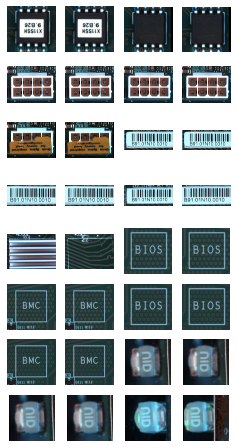

In [64]:
ps = []
fig, axes = plt.subplots(8, 4, figsize=(4, 8))
for (p,), ax in zip(rows, axes.flatten()):
    ps.append(p)
#     ax.set_title(f'{os.path.split(p)[1]}')
    ax.imshow(Image.open(p))
    ax.axis("off")

### other type of duplicates

In [73]:
c.execute(f"""select path from metadata
where filename in (
    select filename from metadata
    where component_class = 'label' or
          component_class = 'heat_sink' or
          component_class = 'screw'
    group by filename
    having count(*) > 1
    )
order by filename
""")

c.fetchmany(10)

[('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-17/5550190100060150019AJ0T1_LABEL-MAC_270_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-15/5550190100060150019AJ0T1_LABEL-MAC_270_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-17/55501901000701500046J0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-14/55501901000701500046J0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-17/55501901000701500114J0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-14/55501901000701500114J0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-17/5550190100070150013BJ0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D11/OK/2020-04-14/5550190100070150013BJ0T1_LABELBIOS_000_000_000.jpg',),
 ('/data/aoi-wzs-p1-dip-fa-nvidia/data-center/D1

## export to metadata.db

In [76]:
# for check the same path but diff label
diff_label_path = c.execute('''
    SELECT * FROM metadata JOIN dc_metadata 
    ON metadata.path = dc_metadata.path
    WHERE metadata.label <> dc_metadata.label
''').fetchall()
len(diff_label_path)

0

In [79]:
# c.execute('drop table dc_metadata')
# c.execute('commit')
conn.commit()
conn.close()

In [74]:
c.execute("""select count(*) from metadata
where
    (component_class = 'label' or
    component_class = 'heat_sink' or
    component_class = 'screw') and
    date > '2020-05-15'
    """)
c.fetchone()

(16796,)

In [75]:
c.execute("""select * from metadata
where
    (component_class = 'label' or
    component_class = 'heat_sink' or
    component_class = 'screw') and
    date > '2020-05-15'
    """)

In [ ]:
DB_PATH = "/data/aoi-wzs-p1-dip-fa-nvidia/metadata.db"
dest = sqlite3.connect(DB_PATH)
d = dest.cursor()

# with dest:
#     dest.executemany("""insert into metadata
#         values(?,?,?,?,?,?,?,?,?,?,?,?)""", c)

with dest:
    for row in c:
        try:
            d.execute("insert into metadata values (?,?,?,?,?,?,?,?,?,?,?,?)", row)
        except sqlite3.IntegrityError:
            # print(f"integrity error: {row[0]}")
            continue
        except Exception as e:
            print(f"unknown error: {row}, {e}")
            break

In [ ]:
d.execute(f"""select count(*) from metadata
        where
            (component_class = 'label' or
            component_class = 'screw' or
            component_class = 'heat_sink'
            ) and
            path like '%data-center%' and
            date > '2020-07-06'
        """)

d.fetchone()

In [ ]:
dest.close()

In [ ]:
conn.close()

# data-center calculate per week

In [ ]:
import os
import datetime
import pandas as pd

In [ ]:
def parse_path(path):
    head, filename = os.path.split(path)
    base, _ = os.path.splitext(filename)

    h = head.split(os.path.sep)
    b = base.split("_")
    t = os.path.getmtime(path)

    assert len(h) == 7, f"{path}"

    # KEYS = ["path", "filename", "timestamp", "line", "label", "component_class"]
    if len(b) == 5 or len(b) == 8 or len(b) == 11: # 8 because some have extra _000_000_000 in the end
        return [path, filename, t, h[-3], label_lookup(h[-2]), component_class_lookup(b[1])]
    elif len(b) == 6: # 6 because some component has underscore
        return [path, filename, t, h[-3], label_lookup(h[-2]), component_class_lookup(b[1])]
    else:
        raise ValueError(f"{path}")

def label_lookup(label):
    table = {
        "OK": "OK",
        "NG": "NG",
        "OK(Overkill)": "Overkill",
        "NG(Underkill)": "Underkill",
    }
    return table.get(label, None)

In [ ]:
x = pd.DataFrame()

In [ ]:
week = "W16"
startdate = datetime.date(2020, 4, 17)
enddate = startdate + datetime.timedelta(weeks=1)

# fetch paths
d = startdate
paths = []
while d < enddate:
    pattern = f"/data/aoi-wzs-p1-dip-fa-nvidia/data-center/*/*/{d.isoformat()}/*.jpg"
    paths.extend(glob.glob(pattern, recursive=True))

    d += datetime.timedelta(1)

# build data frame
KEYS = ["count", "filename", "timestamp", "line", "label", "component_class"]
d = pd.DataFrame(map(parse_path, paths), columns=KEYS)
d["date"] = d["timestamp"].map(datetime.date.fromtimestamp)
d["hour"] = d["timestamp"].map(lambda x: datetime.datetime.fromtimestamp(x).hour)
d = d.dropna()

# calculate percentage
count_by_c_l = d[(d["label"]=="Overkill")|(d["label"]=="Underkill")].groupby(["component_class", "label"]).agg({"count": "count"})
count_by_c = d.groupby(["component_class"]).agg({"count": "count"})
count_by_c_l["percentage"] = (count_by_c_l.div(count_by_c) * 100).applymap("{:.2f}%".format)
count_by_c_l = count_by_c_l.join(count_by_c, on="component_class", rsuffix="_total")
count_by_c_l["week"] = week

In [ ]:
x = x.append(count_by_c_l)

In [ ]:
x

In [ ]:
x.to_csv("/data/aoi-wzs-p1-dip-fa-nvidia/metrics.csv")

# AXI

format:
`/data/aoi-wzs-p1-dip-fa-nvidia/axi/LABEL/DATE/filename.jpg`

## table schema

In [ ]:
DB_PATH = "/data/aoi-wzs-p1-dip-fa-nvidia/axi.db"

conn = sqlite3.connect(DB_PATH)
c = conn.cursor()

In [ ]:
with conn:
    conn.execute("""create table metadata (
        path text primary key,
        filename text,
        date text,
        label text,
        width integer,
        height integer)""")

In [ ]:
def parse_path(path):
    head, filename = os.path.split(path)

    h = head.split(os.path.sep)

    assert len(h) == 6, f"{path}"
    
    try:
        width, height = Image.open(path).size
    except Image.UnidentifiedImageError:
        print(f"unidentified image: {path}")
        width, height = None, None

    # KEYS = ["path", "filename", "date", "label", "width", "height"]
    return [path, filename, h[-1], h[-2], width, height]

In [ ]:
pattern = "/data/aoi-wzs-p1-dip-fa-nvidia/axi/**/*.jpg"

paths = glob.glob(pattern, recursive=True)

In [ ]:
with conn:
    conn.executemany("insert into metadata values (?,?,?,?,?,?)", map(parse_path, paths))

In [ ]:
c.execute("""select label, count(*) from metadata group by label""")
c.fetchall()

In [ ]:
conn.close()